# LETR Basic Usage Demo

In [6]:

import numpy as np
import torch
import cv2
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 200
import torchvision.transforms.functional as functional
import torch.nn.functional as F
from models import build_model
from util.misc import nested_tensor_from_tensor_list
from shs.eval.image import zscale

torch.cuda.is_available()

True

In [7]:
class Compose(object):
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, image):
        for t in self.transforms:
            image = t(image)
        return image

    def __repr__(self):
        format_string = self.__class__.__name__ + "("
        for t in self.transforms:
            format_string += "\n"
            format_string += "    {0}".format(t)
        format_string += "\n)"
        return format_string

class Normalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std

    def __call__(self, image):
        image = functional.normalize(image, mean=self.mean, std=self.std)
        return image

class ToTensor(object):
    def __call__(self, img):
        return functional.to_tensor(img)

def resize(image, size, max_size=None):
    # size can be min_size (scalar) or (w, h) tuple
    def get_size_with_aspect_ratio(image_size, size, max_size=None):
        w, h = image_size
        if max_size is not None:
            min_original_size = float(min((w, h)))
            max_original_size = float(max((w, h)))
            if max_original_size / min_original_size * size > max_size:
                size = int(round(max_size * min_original_size / max_original_size))
        if (w <= h and w == size) or (h <= w and h == size):
            return (h, w)
        if w < h:
            ow = size
            oh = int(size * h / w)
        else:
            oh = size
            ow = int(size * w / h)
        return (oh, ow)

    def get_size(image_size, size, max_size=None):
        if isinstance(size, (list, tuple)):
            return size[::-1]
        else:
            return get_size_with_aspect_ratio(image_size, size, max_size)

    size = get_size(image.size, size, max_size)
    rescaled_image = functional.resize(image, size)

    return rescaled_image

class Resize(object):
    def __init__(self, sizes, max_size=None):
        assert isinstance(sizes, (list, tuple))
        self.sizes = sizes
        self.max_size = max_size

    def __call__(self, img):
        size = self.sizes
        return resize(img, size, self.max_size)



## Load Model Pre-trained Weights

In [23]:
# obtain checkpoints
checkpoint = torch.load('../exp/oft_50_lines_sumzs/checkpoints/checkpoint0049.pth', map_location='cpu')
#checkpoint = torch.load('../exp/hypspec_oft_stage2/checkpoints/checkpoint0299.pth', map_location='cpu')
#checkpoint = torch.load('../checkpoint0299.pth', map_location='cpu')


# load model
args = checkpoint['args']
model, _, postprocessors = build_model(args)
model.load_state_dict(checkpoint['model'])
model.eval()



LETR(
  (transformer): Transformer(
    (encoder): TransformerEncoder(
      (layers): ModuleList(
        (0): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): Linear(in_features=2048, out_features=256, bias=True)
          (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (1): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
       


## Load and fit Demo Images

0


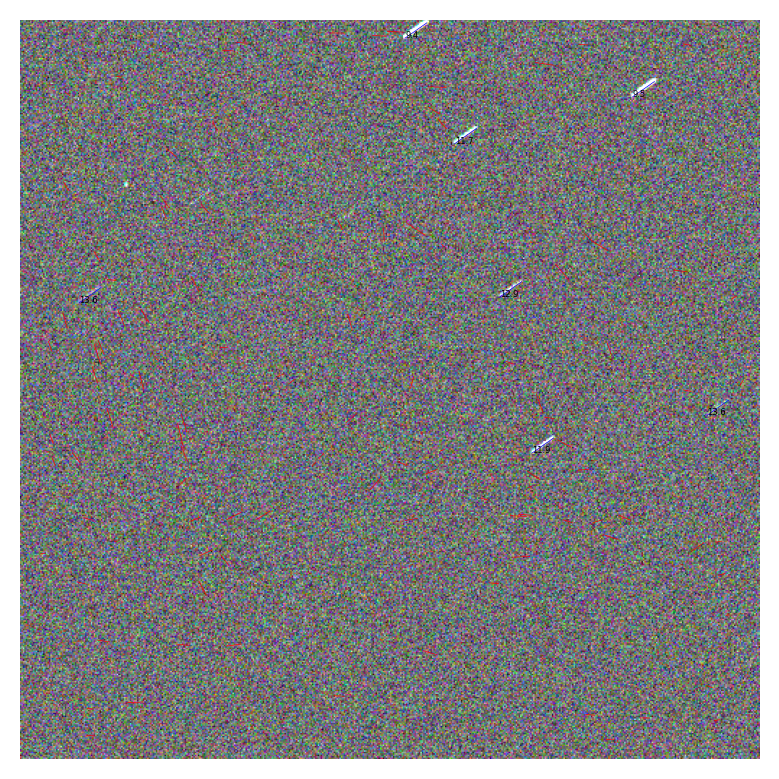

1


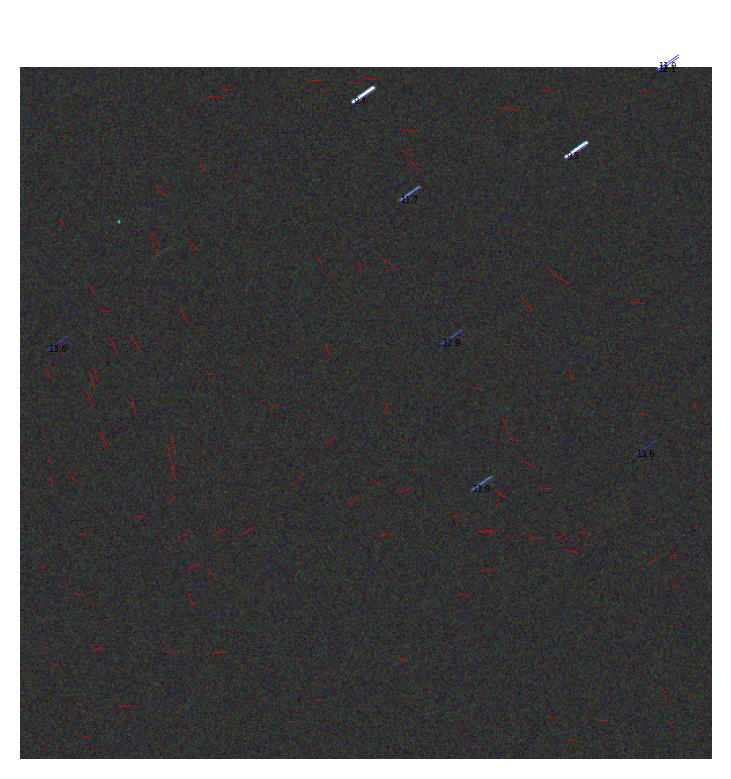

2


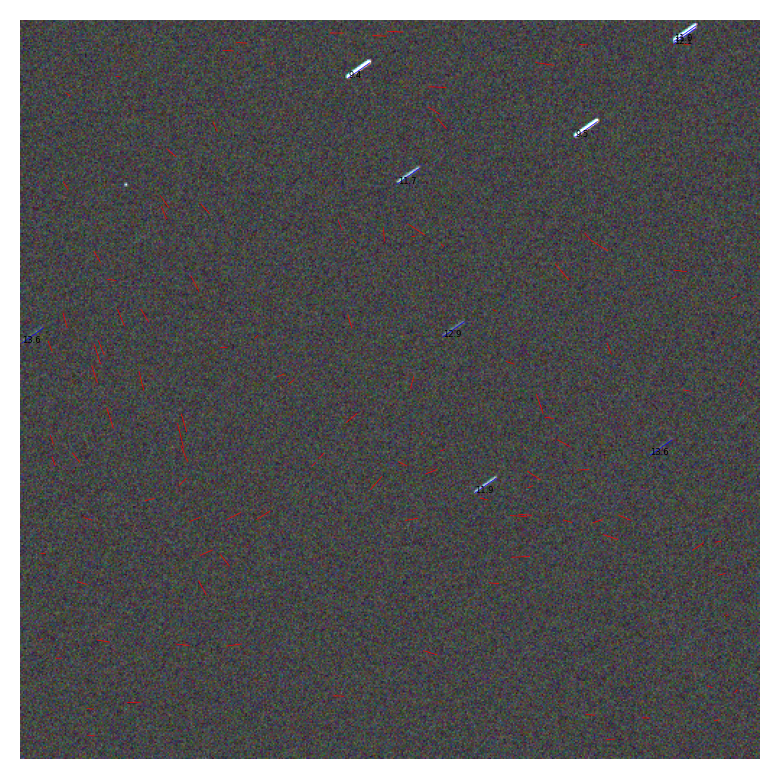

3


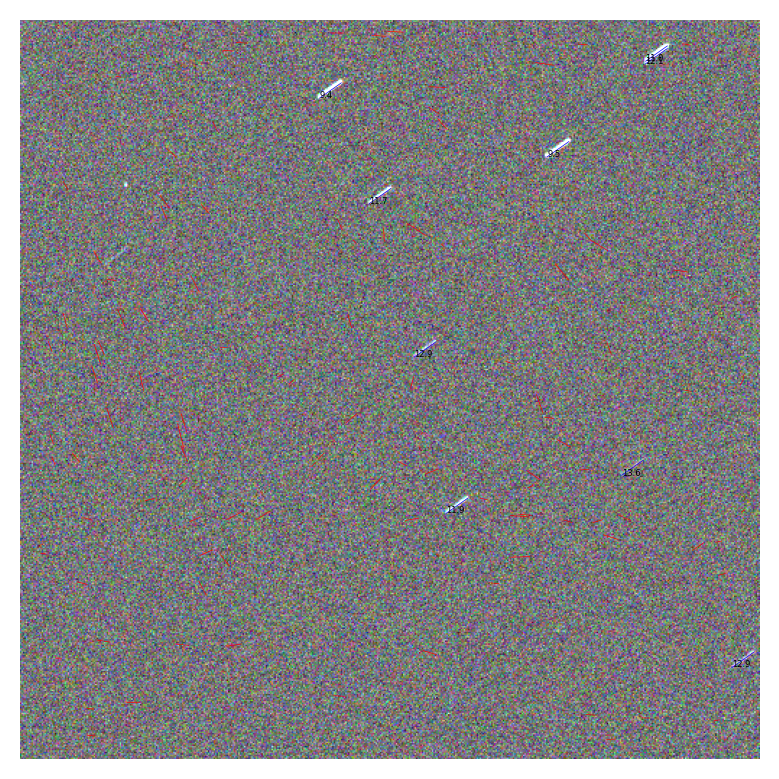

4


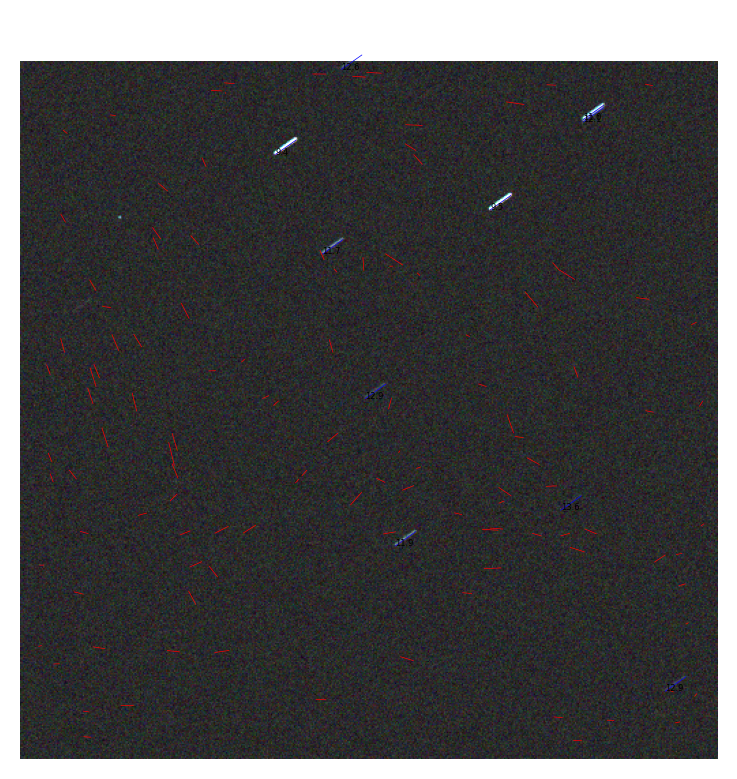

5


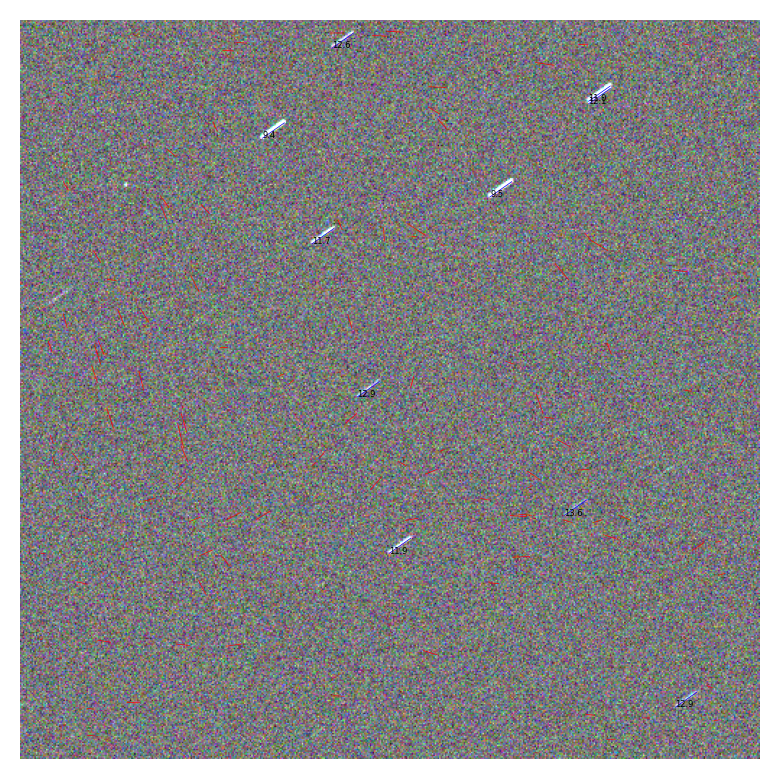

6


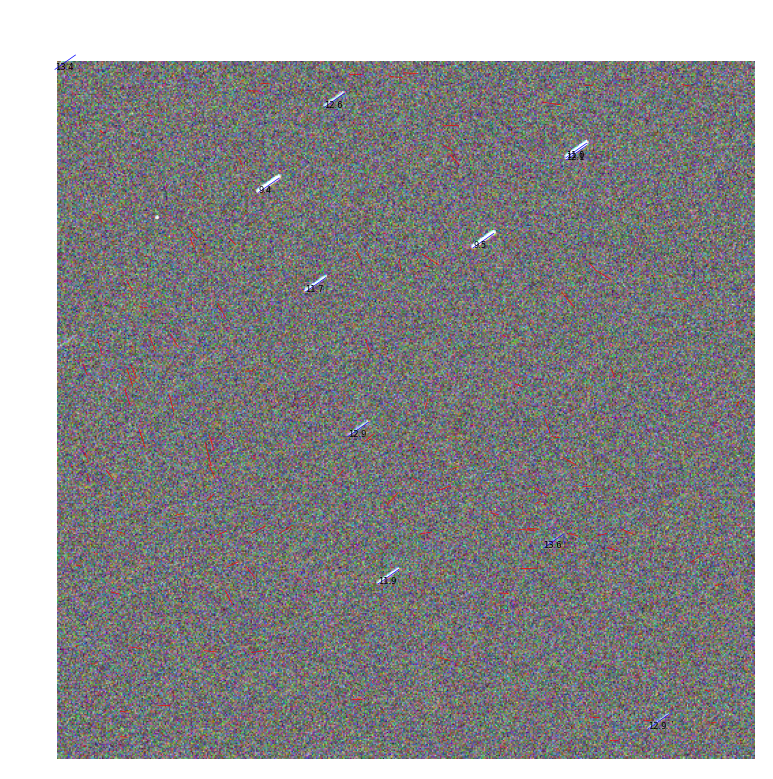

7


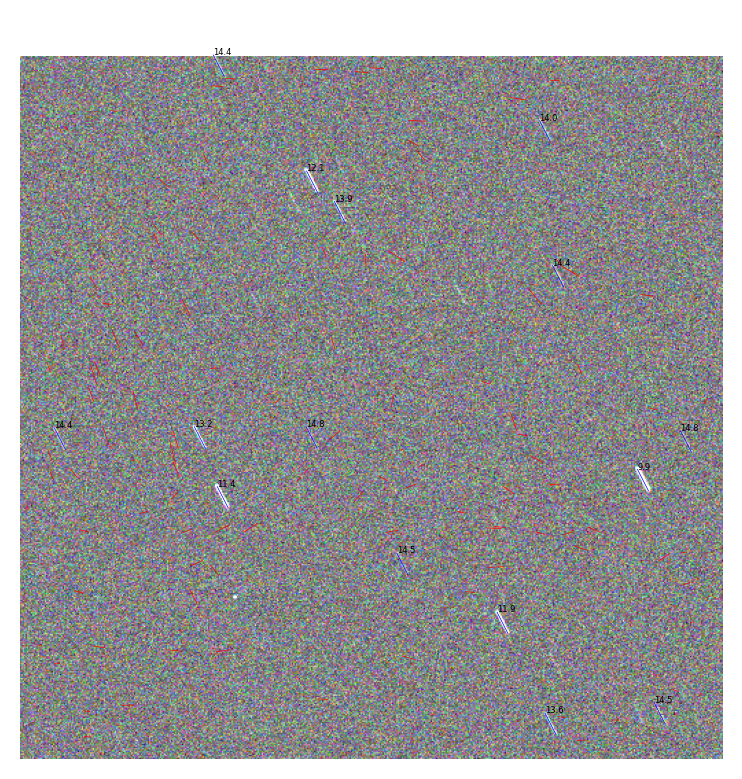

8


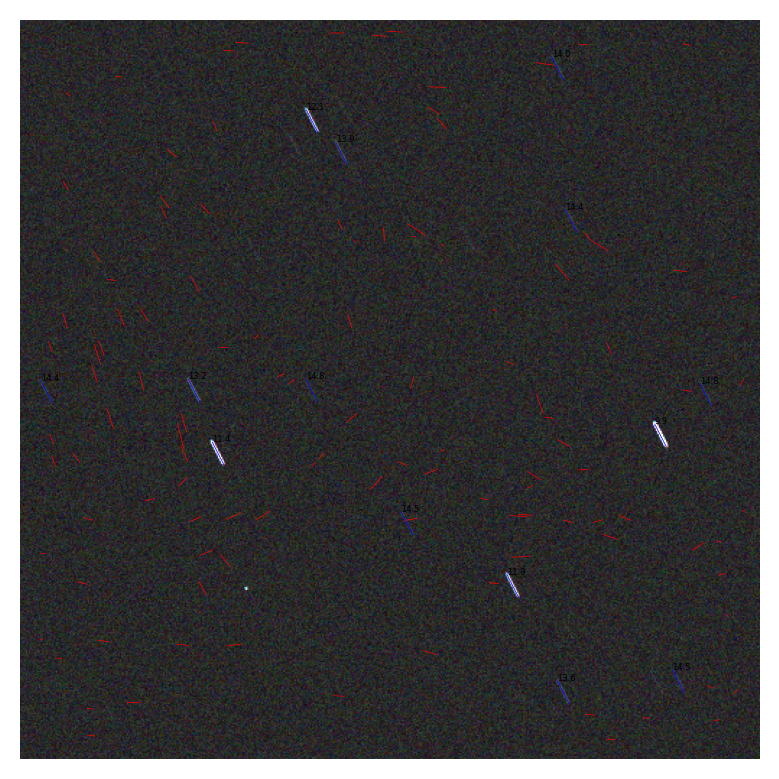

9


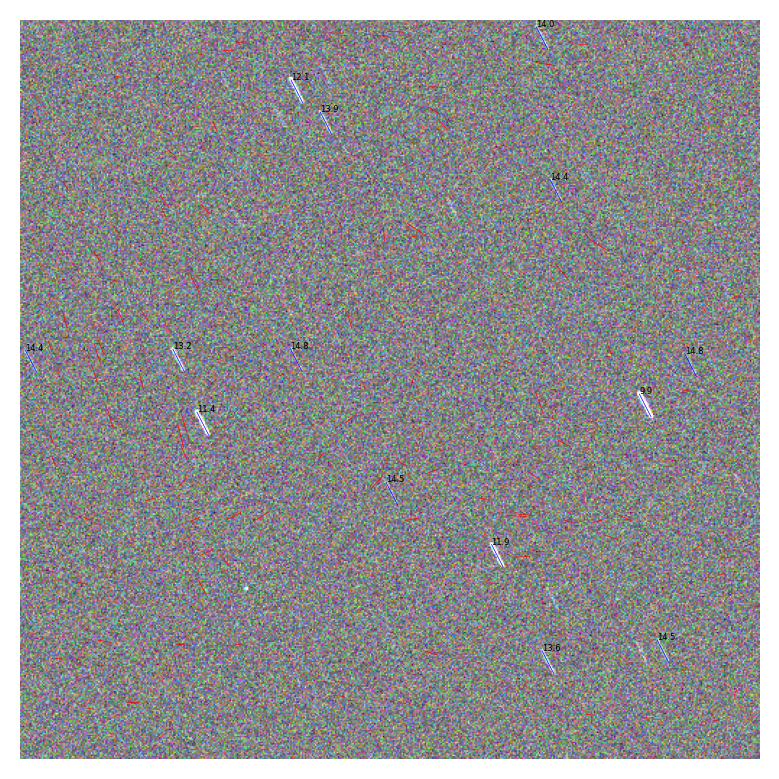

10


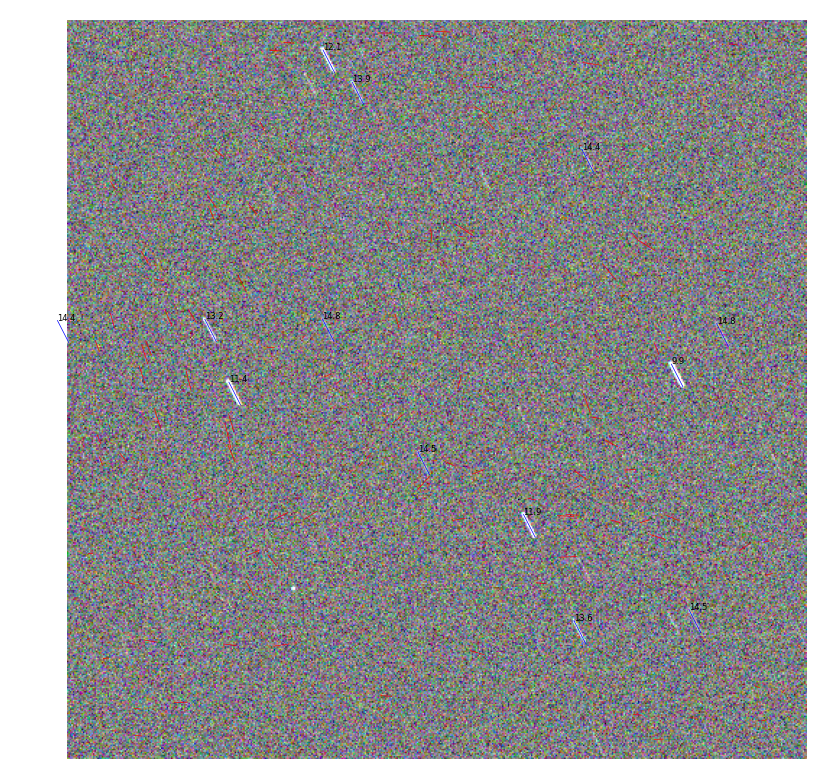

11


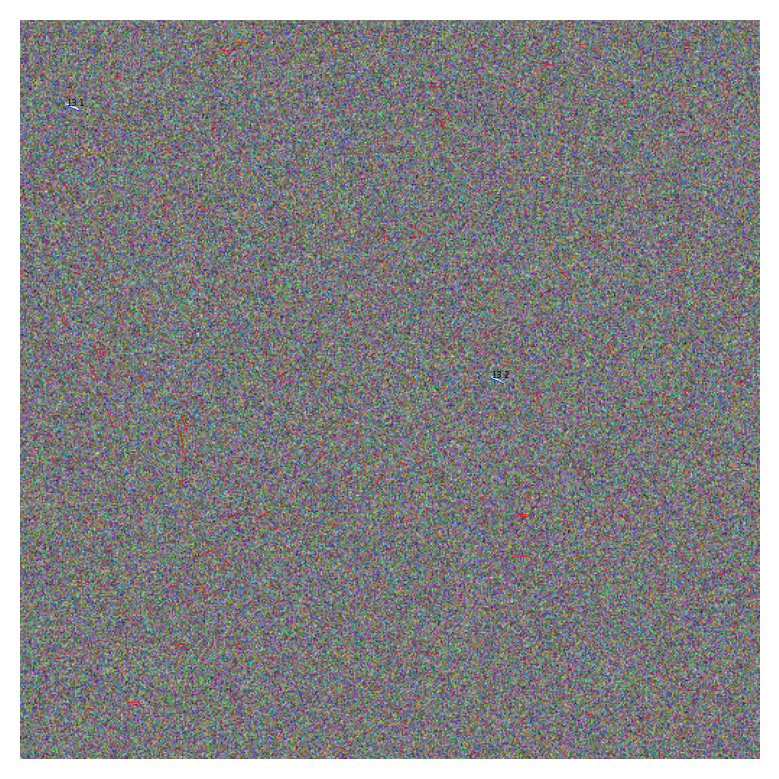

12


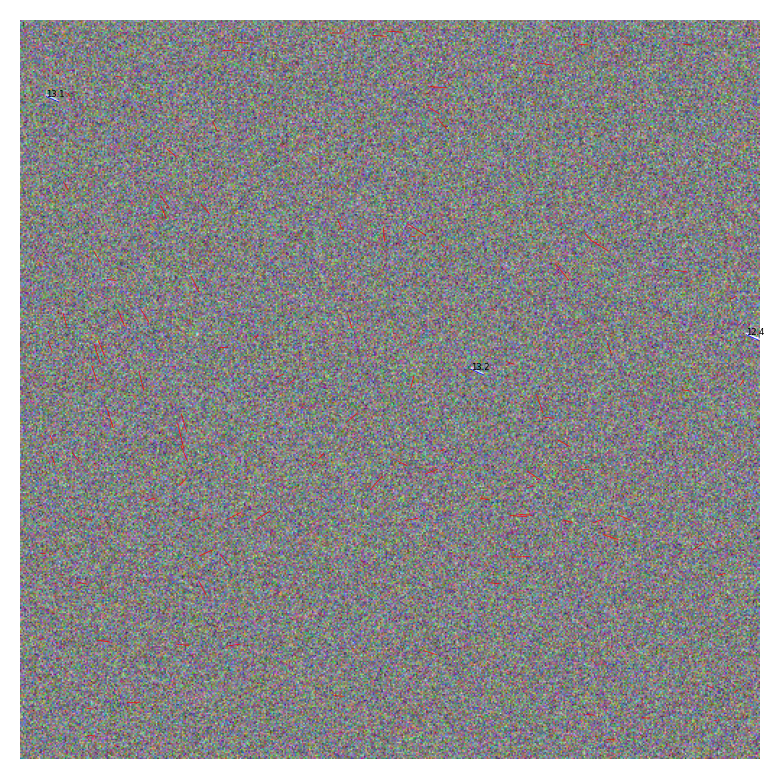

13


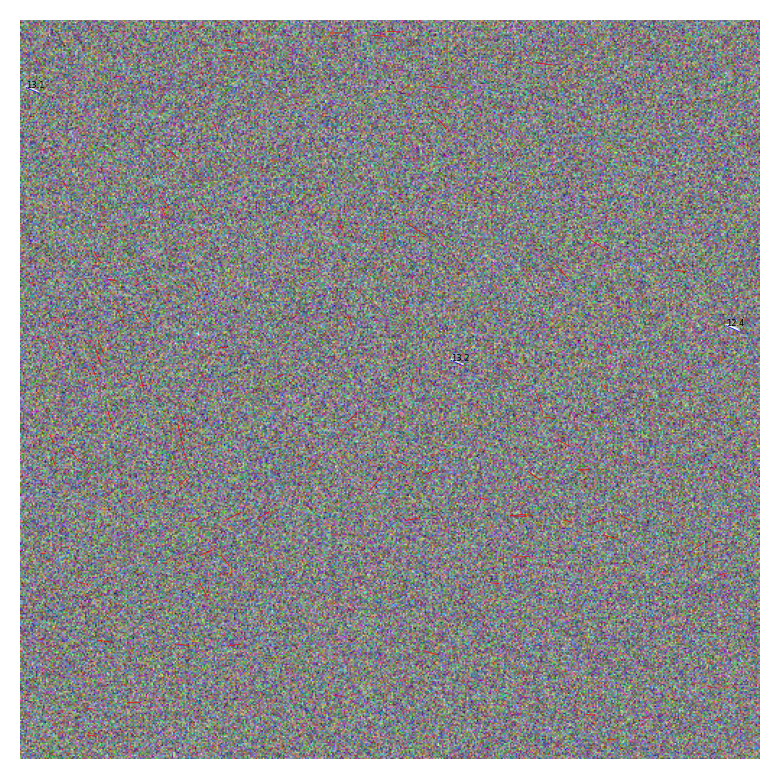

14


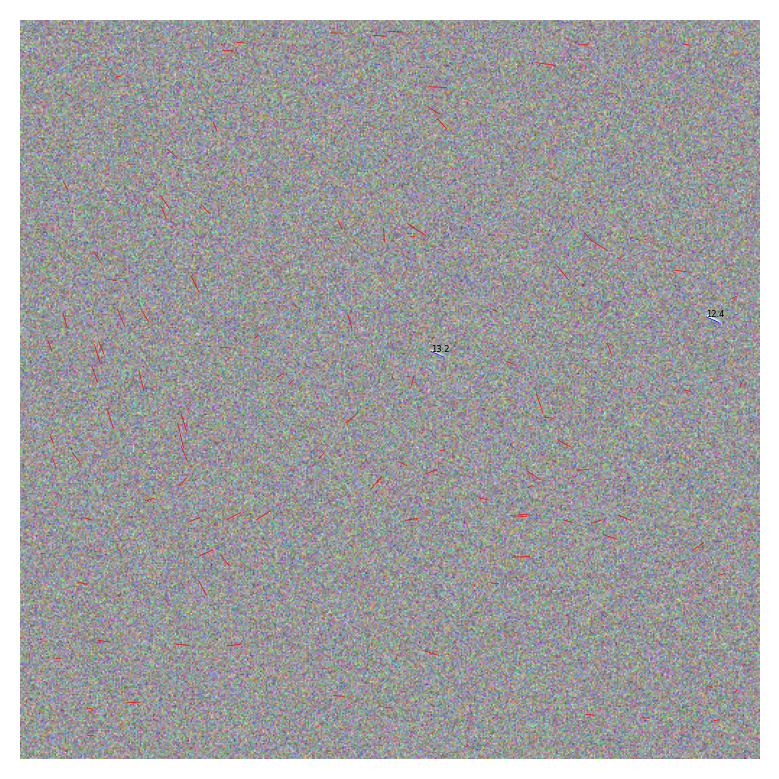

15


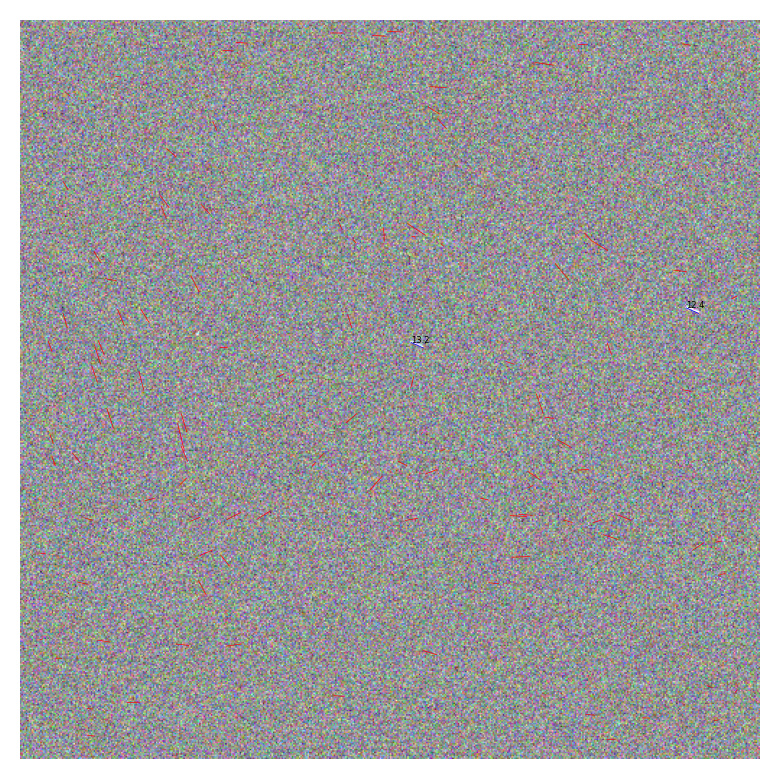

16


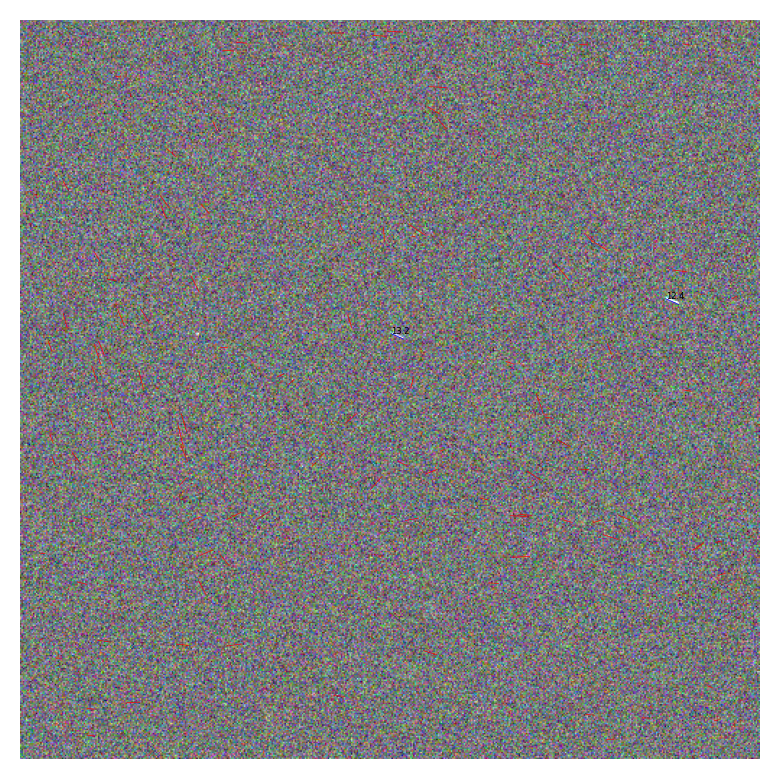

17


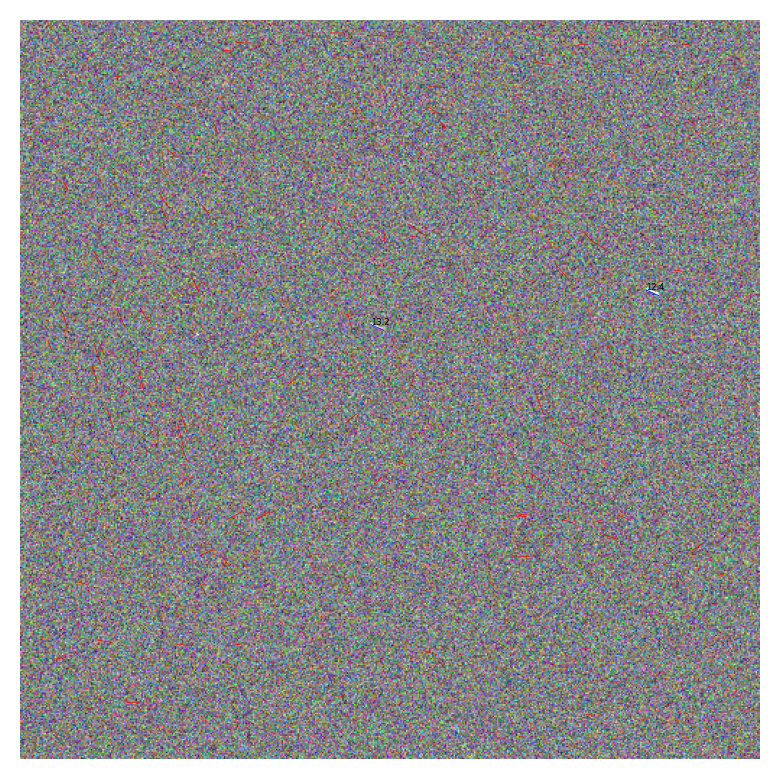

18


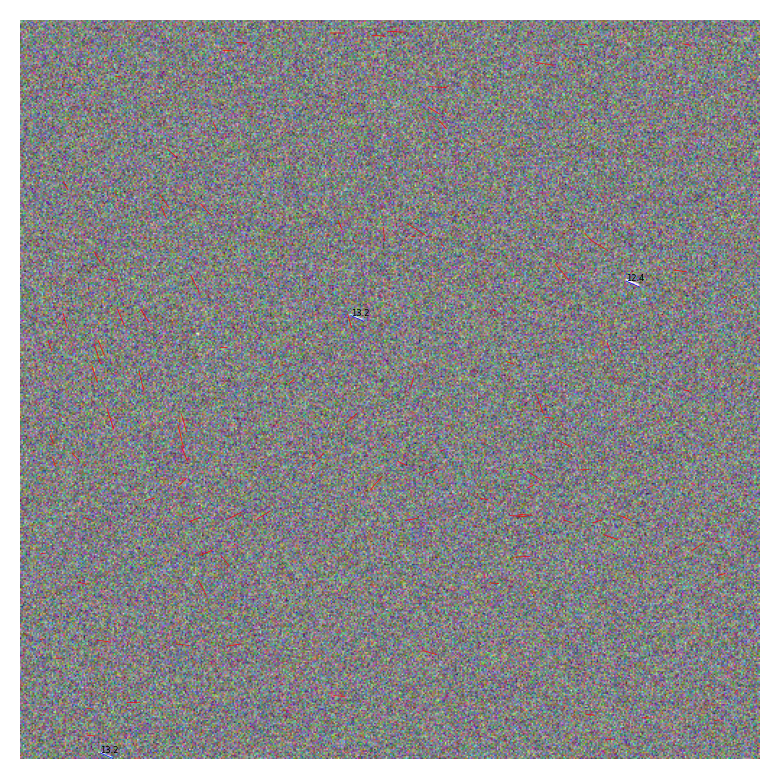

19


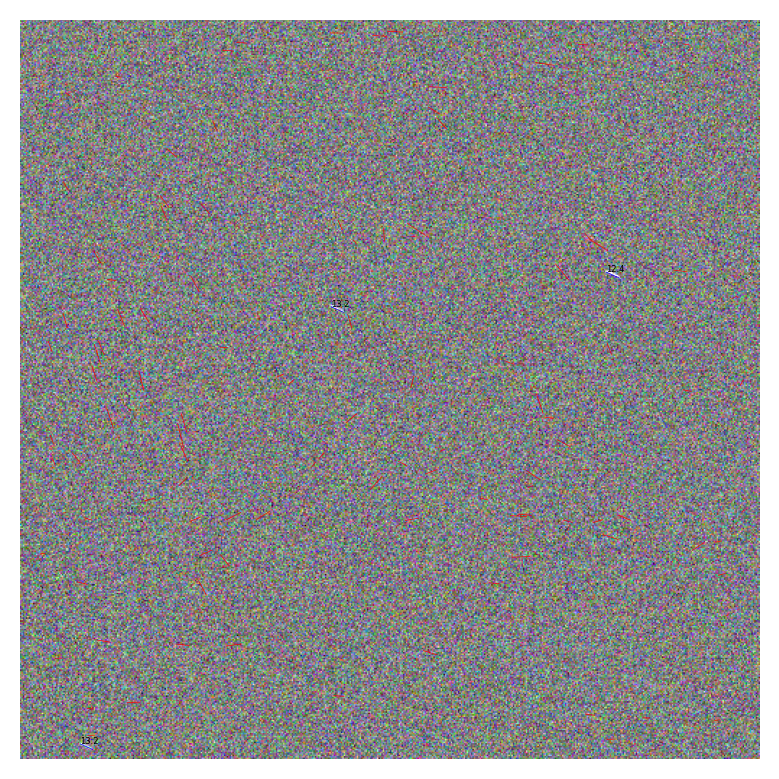

In [25]:
import json
gt = json.load(open('../../spectranet_hyperspectral/.scratch/shs_oft/annotations/lines_train.json','r'))
info = json.load(open('../../spectranet_hyperspectral/.scratch/shs_oft/annotations/info_train.json','r'))
for idx in range(20): # len(gt["images"])):# load image
    print(idx)
    raw_img = plt.imread('../../spectranet_hyperspectral/.scratch/shs_oft/train_sum_zs/%.9i.png'%idx)
    #raw_img = plt.imread('../../spectranet_hyperspectral/.scratch/StarNet-67k/test/abq01.12.10.2017_sat_41866.1317.png')
    raw_img = np.stack([raw_img,raw_img,raw_img],-1)
    h, w = raw_img.shape[0], raw_img.shape[1]
    orig_size = torch.as_tensor([int(h), int(w)])

    # normalize image
    test_size = 512
    normalize = Compose([
            ToTensor(),
            Normalize(info["3c_median"]["mean"],info["3c_median"]["std"]),
            Resize([1100])
        ])


    img = normalize(raw_img)
    inputs = nested_tensor_from_tensor_list([img])
    #plt.axis('off')

    gt_lines = []
    for annot in gt["annotations"]:
        if annot["image_id"] ==idx:
            gt_lines.append([annot["line"][0],annot["line"][1],annot["line"][0]+annot["line"][2],annot["line"][1]+annot["line"][3],annot["mag"]])
    gts = np.array(gt_lines)

    outputs = model(inputs)
    if isinstance(outputs, tuple):
        outputs = outputs[0]
    out_logits, out_line = outputs['pred_logits'], outputs['pred_lines']
    prob = F.softmax(out_logits, -1)
    scores, labels = prob[..., :-1].max(-1)
    img_h, img_w = orig_size.unbind(0)
    scale_fct = torch.unsqueeze(torch.stack([img_w, img_h, img_w, img_h], dim=0), dim=0)
    lines = out_line * scale_fct[:, None, :]
    lines = lines.view(1000, 2, 2)
    lines = lines.flip([-1])# this is yxyx format
    scores = scores.detach().numpy()
    keep = scores >= 0.6
    keep = keep.squeeze()
    lines = lines[keep]
    lines = lines.reshape(lines.shape[0], -1) 

    fig = plt.figure()
    plt.imshow(zscale(raw_img,contrast=.1),cmap="Greys")


    for line in gt_lines:
        x1, y1, x2, y2, mag = line
        p1 = (x1, y1)
        p2 = (x2, y2)
        plt.plot([p1[0], p2[0]], [p1[1], p2[1]], linewidth=.25, color='blue', zorder=1)
        plt.text(x1,y1,round(mag,1) ,fontsize=3)
    
    for tp_id, line in enumerate(lines):
        y1, x1, y2, x2 = line.detach().numpy() # this is yxyx
        
        #x1, y1, x2, y2  = line.detach().numpy()
        p1 = (x1, y1)
        p2 = (x2, y2)
        plt.plot([p1[0], p2[0]], [p1[1], p2[1]], linewidth=.25, color='red', zorder=1)
        
    plt.axis('off')
    plt.savefig("../figures/dsr_%i.png"%idx, dpi=300, bbox_inches='tight', pad_inches = 0)
    
    if idx%1==0:
        plt.show()
    plt.close(fig="all")


    #plt.imshow(zscale(raw_img[:,:,0],contrast=.4))

In [60]:
"%.9i"%22

'000000022'

In [56]:
#load ground truth


## Model Inference

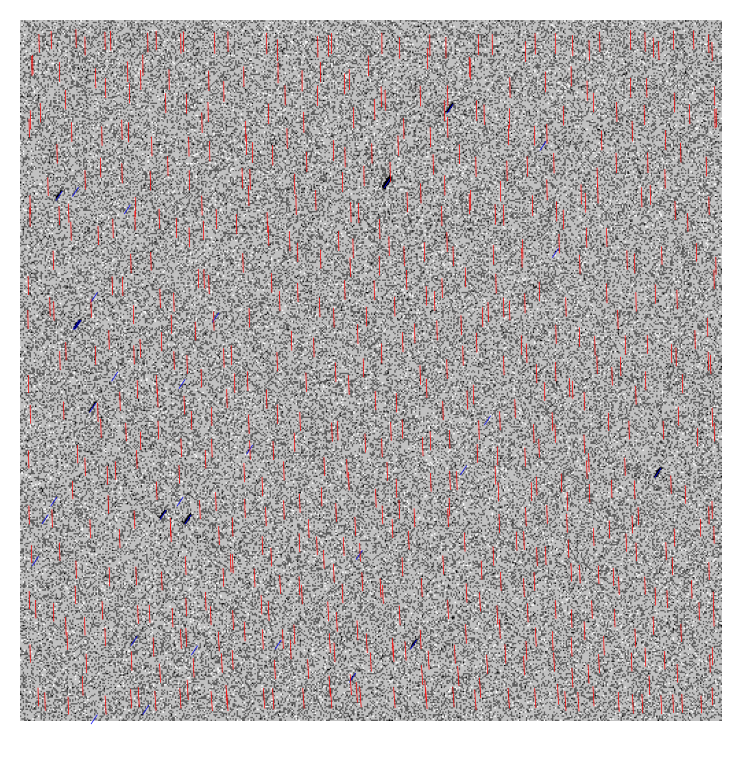

In [59]:

outputs = model(inputs)
if isinstance(outputs, tuple):
    outputs = outputs[0]
out_logits, out_line = outputs['pred_logits'], outputs['pred_lines']
prob = F.softmax(out_logits, -1)
scores, labels = prob[..., :-1].max(-1)
img_h, img_w = orig_size.unbind(0)
scale_fct = torch.unsqueeze(torch.stack([img_w, img_h, img_w, img_h], dim=0), dim=0)
lines = out_line * scale_fct[:, None, :]
lines = lines.view(1000, 2, 2)
lines = lines.flip([-1])# this is yxyx format
scores = scores.detach().numpy()
keep = scores >= 0.6
keep = keep.squeeze()
lines = lines[keep]
lines = lines.reshape(lines.shape[0], -1) 



fig = plt.figure()
plt.imshow(zscale(raw_img[:,:,0],contrast=.4),cmap="Greys")


for line in gt_lines:
    x1, y1, x2, y2 = line
    p1 = (x1, y1)
    p2 = (x2, y2)
    plt.plot([p1[0], p2[0]], [p1[1], p2[1]], linewidth=.25, color='blue', zorder=1)
 
for tp_id, line in enumerate(lines):
    y1, x1, y2, x2 = line.detach().numpy() # this is yxyx
    
    #x1, y1, x2, y2  = line.detach().numpy()
    p1 = (x1, y1)
    p2 = (x2, y2)
    plt.plot([p1[0], p2[0]], [p1[1], p2[1]], linewidth=.25, color='red', zorder=1)
    
plt.axis('off')


plt.savefig("../figures/demo_star_result.png", dpi=300, bbox_inches='tight', pad_inches = 0)
#plt.close(fig)
plt.show()


## Post-processing Results

In [ ]:
out_logits, out_line = outputs['pred_logits'], outputs['pred_lines']
prob = F.softmax(out_logits, -1)
scores, labels = prob[..., :-1].max(-1)
img_h, img_w = orig_size.unbind(0)
scale_fct = torch.unsqueeze(torch.stack([img_w, img_h, img_w, img_h], dim=0), dim=0)
lines = out_line * scale_fct[:, None, :]
lines = lines.view(1000, 2, 2)
lines = lines.flip([-1])# this is yxyx format
scores = scores.detach().numpy()
keep = scores >= 0.6
keep = keep.squeeze()
lines = lines[keep]
lines = lines.reshape(lines.shape[0], -1)




## Plot Inference Results

In [ ]:

fig = plt.figure()
plt.imshow(raw_img)
for tp_id, line in enumerate(lines):
    y1, x1, y2, x2 = line.detach().numpy() # this is yxyx
    p1 = (x1, y1)
    p2 = (x2, y2)
    plt.plot([p1[0], p2[0]], [p1[1], p2[1]], linewidth=.5, color='darkorange', zorder=1)
plt.axis('off')


#plt.savefig("../figures/demo_result.png", dpi=300, bbox_inches='tight', pad_inches = 0)
#plt.close(fig)
plt.show()


In [ ]:
plt.show()